In [1]:
import oceanspy as ospy
od = ospy.open_oceandataset.from_catalog('IGPwinter')

Opening IGPwinter.
High-resolution numerical simulation carried out in parallel to the observational
component of the Iceland Greenland Seas Project (IGP).
Citation:
 * Renfrew et al., 2019 - BAMS.


In [2]:
display(od.dataset)

<xarray.Dataset>
Dimensions:       (Z: 216, Zp1: 217, Zu: 216, Zl: 216, X: 960, Y: 880,
                   Xp1: 961, Yp1: 881, time: 360, time_midp: 359)
Coordinates: (12/18)
  * Z             (Z) float64 -1.0 -3.5 -7.0 ... -3.922e+03 -3.942e+03
  * Zp1           (Zp1) float64 0.0 -2.0 -5.0 ... -3.932e+03 -3.951e+03
  * Zu            (Zu) float64 -2.0 -5.0 -9.0 ... -3.932e+03 -3.951e+03
  * Zl            (Zl) float64 0.0 -2.0 -5.0 ... -3.913e+03 -3.932e+03
  * X             (X) float64 -45.0 -44.76 -44.52 -44.29 ... 23.52 23.76 24.0
  * Y             (Y) float64 57.0 57.08 57.17 57.25 ... 78.75 78.83 78.92 79.0
    ...            ...
  * time          (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
    YU            (Y, Xp1) float64 dask.array<chunksize=(880, 961), meta=np.ndarray>
    XU            (Y, Xp1) float64 dask.array<chunksize=(880, 961), meta=np.ndarray>
    YV            (Yp1, X) float64 dask.array<chunksize=(881, 960), meta=np.ndarray>
    XV            (Yp1, X) float64 dask.array<chunksize=(881, 960), meta=np.ndarray>
  * time_midp     (time_midp) datetime64[ns] 2018-01-01T03:00:00 ... 2018-03-...
Data variables: (12/102)
    drC           (Zp1) float64 dask.array<chunksize=(217,), meta=np.ndarray>
    drF           (Z) float64 dask.array<chunksize=(216,), meta=np.ndarray>
    dxC           (Y, Xp1) float64 dask.array<chunksize=(880, 961), meta=np.ndarray>
    dyC           (Yp1, X) float64 dask.array<chunksize=(881, 960), meta=np.ndarray>
    dxF           (Y, X) float64 dask.array<chunksize=(880, 960), meta=np.ndarray>
    dyF           (Y, X) float64 dask.array<chunksize=(880, 960), meta=np.ndarray>
    ...            ...
    SItflux       (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    SIaaflux      (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    SIhl          (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    SIempmr       (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    oceSPflx      (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    oceSPDep      (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
Attributes: (12/23)
    MITgcm_version:        checkpoint67l
    build_user:            malmans2@jhu.edu
    build_host:            compute0673
    build_date:            Fri Nov  8 01:36:45 EST 2019
    MITgcm_URL:            http://mitgcm.org
    MITgcm_tag_id:         
    ...                    ...
    Nr:                    216
    OceanSpy_parameters:   {'rSphere': 6371.0, 'eq_state': 'mdjwf', 'rho0': 1...
    OceanSpy_name:         IGP
    OceanSpy_description:  High-resolution numerical simulation carried out i...
    OceanSpy_projection:   Mercator(**{})
    OceanSpy_grid_coords:  {'Y': {'Y': None, 'Yp1': 0.5}, 'X': {'X': None, 'X...

In [3]:
# Slhl (Ocean surface freshwater flux, > 0 increases salt)
# SlatmFW (Net freshwater flux from atmosphere & land (+=down))
# SlatmTx (Zonal surface wind stress over Ocean+SeaIce)
# SlatmTy (Merid surface wind stress over Ocean+SeaIce)
# Sltaux (SEAICE zonal surface wind stress, >0 increases uIce)
# Sltauy (SEAICE merid surface wind stress, >0 increases vIce)
# Sluiec (SEAICE zonal ice velocity, >0 from West to East)
# Slvice (SEAICE merid. ice velocity, >0 from South to North)
# Slarea (SEAICE fractional ice-covered area [0 to 1])
# EXFpress (atmospheric pressure field)
# EXFempmr (net upward freshwater flux, > 0 increases salinity)
# EXFpreci (precipitation, > 0 decreases salinity)
# EXFevap (evaporation, > 0 increases salinity)
# EXFvwind (meridional 10-m wind speed, >0 increases uVel)
# EXFuwind (zonal 10-m wind speed, >0 increases uVel)
# MXLDEPTH (Mixed-Layer Depth (>0))
# botTauX (zonal bottom stress, >0 increases uVel)
# botTauY (meridional bottom stress, >0 increases vVel)
# oceFWflx (net surface Fresh-Water flux into the ocean (+=down), >0 decreases salinity)
# Eta (free-surface_r-anomaly)
# W (Vertical Component of Velocity)
# U (Zonal Component of Velocity)
# V (Meridional Component of Velocity)
# S (salinity)
# Temp (potential_temperature)
# Depth (ocean depth)
# fCori (Coriolis f at cell center)

In [4]:
# subsampling 
od_cut = od.subsample.cutout(
    XRange=[-40,12],YRange=[65,79],ZRange=0,
    varList=[
    'SIhl',#(Ocean surface freshwater flux, > 0 increases salt)
    'SIatmFW',#(Net freshwater flux from atmosphere & land (+=down))
    'SIatmTx',#(Zonal surface wind stress over Ocean+SeaIce)
    'SIatmTy',#(Merid surface wind stress over Ocean+SeaIce)
    'SItaux',#(SEAICE zonal surface wind stress, >0 increases uIce)
    'SItauy',#(SEAICE merid surface wind stress, >0 increases vIce)
    'SIuice',# (SEAICE zonal ice velocity, >0 from West to East)
    'SIvice',# (SEAICE merid. ice velocity, >0 from South to North)
    'SIarea',# (SEAICE fractional ice-covered area [0 to 1])
    'EXFpress',# (atmospheric pressure field)
    'EXFempmr',# (net upward freshwater flux, > 0 increases salinity)
    'EXFpreci',# (precipitation, > 0 decreases salinity)
    'EXFevap',# (evaporation, > 0 increases salinity)
    'EXFvwind',# (meridional 10-m wind speed, >0 increases uVel)
    'EXFuwind',# (zonal 10-m wind speed, >0 increases uVel)
    'MXLDEPTH',# (Mixed-Layer Depth (>0))
    'botTauX',# (zonal bottom stress, >0 increases uVel)
    'botTauY',# (meridional bottom stress, >0 increases vVel)
    'oceFWflx',# (net surface Fresh-Water flux into the ocean (+=down), >0 decreases salinity)
    'Eta',# (free-surface_r-anomaly)
    'W',# (Vertical Component of Velocity)
    'U',# (Zonal Component of Velocity)
    'V',# (Meridional Component of Velocity)
    'S',# (salinity)
    'Temp',# (potential_temperature)
    'Depth',# (ocean depth)
    'fCori'#(Coriolis f at cell center)
    ]
)
od_cut = od_cut.set_name("cutout",overwrite=False)

Cutting out the oceandataset.


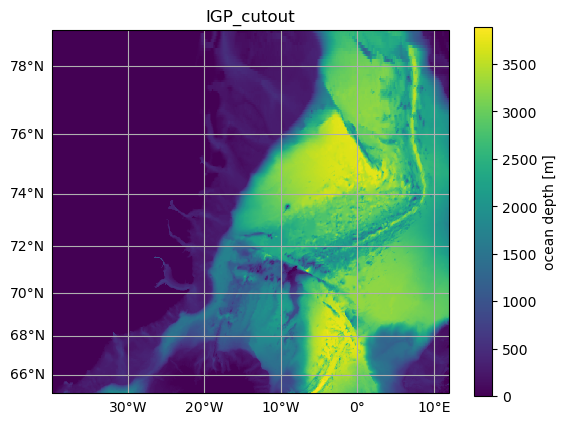

In [5]:
# Plot the cutout domain
ax = od_cut.plot.horizontal_section(varName="Depth")
title = ax.set_title(od_cut.name)

In [6]:
display(od_cut.dataset)

<xarray.Dataset>
Dimensions:    (Z: 1, Zp1: 2, Zu: 1, Zl: 1, X: 853, Y: 628, Xp1: 854, Yp1: 629,
                time: 360, time_midp: 359)
Coordinates: (12/18)
  * Z          (Z) float64 -1.0
  * Zp1        (Zp1) float64 0.0 -2.0
  * Zu         (Zu) float64 -2.0
  * Zl         (Zl) float64 0.0
  * X          (X) float64 -39.85 -39.69 -39.52 -39.37 ... 11.72 11.82 11.92
  * Y          (Y) float64 65.01 65.03 65.04 65.06 ... 78.67 78.75 78.83 78.92
    ...         ...
  * time       (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
    YU         (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    XU         (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    YV         (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
    XV         (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
  * time_midp  (time_midp) datetime64[ns] 2018-01-01T03:00:00 ... 2018-03-31T...
Data variables: (12/27)
    fCori      (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
    Depth      (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
    U          (time, Z, Y, Xp1) float64 dask.array<chunksize=(4, 1, 628, 854), meta=np.ndarray>
    V          (time, Z, Yp1, X) float64 dask.array<chunksize=(4, 1, 629, 853), meta=np.ndarray>
    Temp       (time, Z, Y, X) float64 dask.array<chunksize=(4, 1, 628, 853), meta=np.ndarray>
    S          (time, Z, Y, X) float64 dask.array<chunksize=(4, 1, 628, 853), meta=np.ndarray>
    ...         ...
    SItaux     (time, Y, Xp1) float64 dask.array<chunksize=(4, 628, 854), meta=np.ndarray>
    SItauy     (time, Yp1, X) float64 dask.array<chunksize=(4, 629, 853), meta=np.ndarray>
    SIatmTx    (time, Y, Xp1) float64 dask.array<chunksize=(4, 628, 854), meta=np.ndarray>
    SIatmTy    (time, Yp1, X) float64 dask.array<chunksize=(4, 629, 853), meta=np.ndarray>
    SIatmFW    (time, Y, X) float64 dask.array<chunksize=(4, 628, 853), meta=np.ndarray>
    SIhl       (time, Y, X) float64 dask.array<chunksize=(4, 628, 853), meta=np.ndarray>
Attributes: (12/24)
    MITgcm_version:          checkpoint67l
    build_user:              malmans2@jhu.edu
    build_host:              compute0673
    build_date:              Fri Nov  8 01:36:45 EST 2019
    MITgcm_URL:              http://mitgcm.org
    MITgcm_tag_id:           
    ...                      ...
    OceanSpy_parameters:     {'rSphere': 6371.0, 'eq_state': 'mdjwf', 'rho0':...
    OceanSpy_name:           IGP_cutout
    OceanSpy_description:    High-resolution numerical simulation carried out...
    OceanSpy_projection:     Mercator(**{})
    OceanSpy_grid_coords:    {'Y': {'Y': None, 'Yp1': 0.5}, 'X': {'X': None, ...
    OceanSpy_grid_periodic:  []

In [7]:
pot_dens = od_cut.compute.potential_density_anomaly()

Computing potential density anomaly using the following parameters: {'eq_state': 'mdjwf'}.


In [8]:
display(pot_dens.dataset)

<xarray.Dataset>
Dimensions:    (Z: 1, Zp1: 2, Zu: 1, Zl: 1, X: 853, Y: 628, Xp1: 854, Yp1: 629,
                time: 360, time_midp: 359)
Coordinates: (12/18)
  * Z          (Z) float64 -1.0
  * Zp1        (Zp1) float64 0.0 -2.0
  * Zu         (Zu) float64 -2.0
  * Zl         (Zl) float64 0.0
  * X          (X) float64 -39.85 -39.69 -39.52 -39.37 ... 11.72 11.82 11.92
  * Y          (Y) float64 65.01 65.03 65.04 65.06 ... 78.67 78.75 78.83 78.92
    ...         ...
  * time       (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
    YU         (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    XU         (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    YV         (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
    XV         (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
  * time_midp  (time_midp) datetime64[ns] 2018-01-01T03:00:00 ... 2018-03-31T...
Data variables: (12/28)
    fCori      (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
    Depth      (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
    U          (time, Z, Y, Xp1) float64 dask.array<chunksize=(4, 1, 628, 854), meta=np.ndarray>
    V          (time, Z, Yp1, X) float64 dask.array<chunksize=(4, 1, 629, 853), meta=np.ndarray>
    Temp       (time, Z, Y, X) float64 dask.array<chunksize=(4, 1, 628, 853), meta=np.ndarray>
    S          (time, Z, Y, X) float64 dask.array<chunksize=(4, 1, 628, 853), meta=np.ndarray>
    ...         ...
    SItauy     (time, Yp1, X) float64 dask.array<chunksize=(4, 629, 853), meta=np.ndarray>
    SIatmTx    (time, Y, Xp1) float64 dask.array<chunksize=(4, 628, 854), meta=np.ndarray>
    SIatmTy    (time, Yp1, X) float64 dask.array<chunksize=(4, 629, 853), meta=np.ndarray>
    SIatmFW    (time, Y, X) float64 dask.array<chunksize=(4, 628, 853), meta=np.ndarray>
    SIhl       (time, Y, X) float64 dask.array<chunksize=(4, 628, 853), meta=np.ndarray>
    Sigma0     (time, Z, Y, X) float64 dask.array<chunksize=(4, 1, 628, 853), meta=np.ndarray>
Attributes: (12/24)
    MITgcm_version:          checkpoint67l
    build_user:              malmans2@jhu.edu
    build_host:              compute0673
    build_date:              Fri Nov  8 01:36:45 EST 2019
    MITgcm_URL:              http://mitgcm.org
    MITgcm_tag_id:           
    ...                      ...
    OceanSpy_parameters:     {'rSphere': 6371.0, 'eq_state': 'mdjwf', 'rho0':...
    OceanSpy_name:           IGP_cutout
    OceanSpy_description:    High-resolution numerical simulation carried out...
    OceanSpy_projection:     Mercator(**{})
    OceanSpy_grid_coords:    {'Y': {'Y': None, 'Yp1': 0.5}, 'X': {'X': None, ...
    OceanSpy_grid_periodic:  []

In [9]:
pot_dens_cut = pot_dens.subsample.cutout(
    varList=['Sigma0']
)

Cutting out the oceandataset.


In [10]:
display(pot_dens_cut.dataset)
# pot_dens_cut.to_netcdf('pot_dens.nc')

<xarray.Dataset>
Dimensions:    (Z: 1, Zp1: 2, Zu: 1, Zl: 1, X: 853, Y: 628, Xp1: 854, Yp1: 629,
                time: 360, time_midp: 359)
Coordinates: (12/18)
  * Z          (Z) float64 -1.0
  * Zp1        (Zp1) float64 0.0 -2.0
  * Zu         (Zu) float64 -2.0
  * Zl         (Zl) float64 0.0
  * X          (X) float64 -39.85 -39.69 -39.52 -39.37 ... 11.72 11.82 11.92
  * Y          (Y) float64 65.01 65.03 65.04 65.06 ... 78.67 78.75 78.83 78.92
    ...         ...
  * time       (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
    YU         (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    XU         (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    YV         (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
    XV         (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
  * time_midp  (time_midp) datetime64[ns] 2018-01-01T03:00:00 ... 2018-03-31T...
Data variables:
    Sigma0     (time, Z, Y, X) float64 dask.array<chunksize=(4, 1, 628, 853), meta=np.ndarray>
Attributes: (12/24)
    MITgcm_version:          checkpoint67l
    build_user:              malmans2@jhu.edu
    build_host:              compute0673
    build_date:              Fri Nov  8 01:36:45 EST 2019
    MITgcm_URL:              http://mitgcm.org
    MITgcm_tag_id:           
    ...                      ...
    OceanSpy_parameters:     {'rSphere': 6371.0, 'eq_state': 'mdjwf', 'rho0':...
    OceanSpy_name:           IGP_cutout
    OceanSpy_description:    High-resolution numerical simulation carried out...
    OceanSpy_projection:     Mercator(**{})
    OceanSpy_grid_coords:    {'Y': {'Y': None, 'Yp1': 0.5}, 'X': {'X': None, ...
    OceanSpy_grid_periodic:  []

In [11]:
# anim = pot_dens.animate.horizontal_section(
#     varName="Sigma0",
#     contourName="Depth",
#     center=False,
#     cmap="Spectral_r",
#     robust=True,
#     cutout_kwargs={"ZRange": 0, "dropAxes": True},
#     display=False,
# )

# # The following code is necessary to display the animation in the documentation.
# # When the notebook is executed, remove the code below and set
# # display=True in the command above to show the animation.
# import matplotlib.pyplot as plt

# dirName = "_static"
# import os

# try:
#     os.mkdir(dirName)
# except FileExistsError:
#     pass
# anim.save("{}/Potential_density_anom.mp4".format(dirName))
# plt.close()
# !ffmpeg -loglevel panic -y -i _static/tutorial.mp4 -filter_complex "[0:v] fps=12,scale=480:-1,split [a][b];[a] palettegen [p];[b][p] paletteuse" _static/tutorial.gif
# !rm -f _static/tutorial.mp4

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from matplotlib.animation import FuncAnimation
from IPython.display import Image, display

def animation_local(data,name):
    """ Efficient version """
    T = len(data)
    vmin = data.min().values  # Ensure to extract values if data is xarray
    vmax = data.max().values  # Ensure to extract values if data is xarray

    # Create new figure and add subplots to the figure with 3D projection
    fig, ax1 = plt.subplots(figsize=(12, 8))
    ax1 = fig.add_subplot(111)
    ax1.set_ylabel('Latitude [$^o$N]')
    ax1.set_xlabel('Longitude [$^o$E]')
    c = ax1.pcolor(data.X, data.Y, data[0][0], vmin=vmin, vmax=vmax, cmap='viridis')
    cbar = fig.colorbar(c, ax=ax1, orientation='vertical')
    cbar.set_label('Kg m$^{-3}$')

    # Function to update the plot for each frame of the animation
    def update_plot(frame):
        ax1.clear()
        # actually plot what you want
        ax1.set_title(f'{name} at t={data.time[int(frame)].values}')
        c = ax1.pcolor(data.X,data.Y,data[frame][0],vmin=vmin, vmax=vmax, cmap='viridis') # frame is then the index used for the figure

    # make the actual GIF
    ani = FuncAnimation(fig, update_plot, frames=T, interval=100)

    # Save, close, and display
    ani.save(f'{name}.gif', writer='pillow')
    plt.close(fig)
    display(Image(f'{name}.gif'))

In [13]:
salinity = pot_dens['S']

In [14]:
display(salinity)

<xarray.DataArray 'S' (time: 360, Z: 1, Y: 628, X: 853)>
dask.array<getitem, shape=(360, 1, 628, 853), dtype=float64, chunksize=(4, 1, 628, 853), chunktype=numpy.ndarray>
Coordinates:
  * Z        (Z) float64 -1.0
  * X        (X) float64 -39.85 -39.69 -39.52 -39.37 ... 11.62 11.72 11.82 11.92
  * Y        (Y) float64 65.01 65.03 65.04 65.06 ... 78.67 78.75 78.83 78.92
    XC       (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
    YC       (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
  * time     (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
Attributes:
    long_name:      salinity
    coordinates:    XC YC RC iter
    standard_name:  sea_water_salinity
    units:          g kg-1

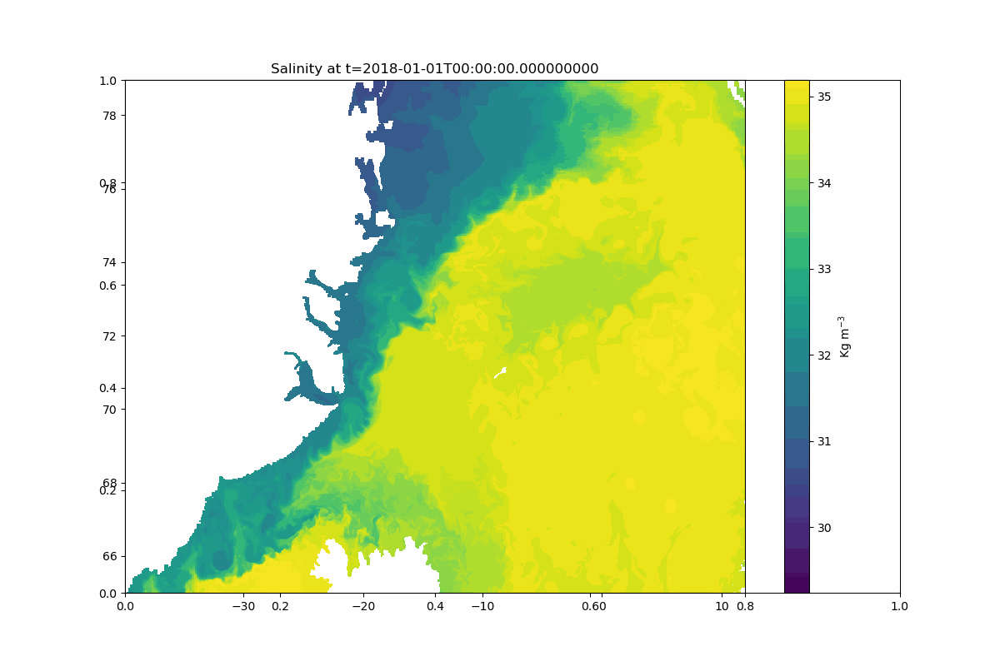

In [15]:
# animation_local(salinity,'Salinity')
display(Image('Salinity.gif'))

In [16]:
# salinity.to_netcdf('salinity.nc')

In [17]:
EKE = od_cut.compute.eddy_kinetic_energy()

Computing weighted_mean.
Computing weighted_mean.
Computing kinetic energy using the following parameters: {'eps_nh': 0}.


In [18]:
EKE_cut = EKE['EKE']

In [19]:
display(EKE_cut)

<xarray.DataArray 'EKE' (time: 360, Z: 1, Y: 628, X: 853)>
dask.array<truediv, shape=(360, 1, 628, 853), dtype=float64, chunksize=(4, 1, 628, 853), chunktype=numpy.ndarray>
Coordinates:
  * Z        (Z) float64 -1.0
  * X        (X) float64 -39.85 -39.69 -39.52 -39.37 ... 11.62 11.72 11.82 11.92
  * Y        (Y) float64 65.01 65.03 65.04 65.06 ... 78.67 78.75 78.83 78.92
    XC       (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
    YC       (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
  * time     (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
Attributes:
    units:                m^2 s^-2
    long_name:            eddy kinetic energy
    OceanSpy_parameters:  {'eps_nh': 0}

In [20]:
# EKE_cut.to_netcdf('EKE.nc')

In [21]:
depth = od_cut['Depth']

In [22]:
display(depth)

<xarray.DataArray 'Depth' (Y: 628, X: 853)>
dask.array<getitem, shape=(628, 853), dtype=float64, chunksize=(628, 853), chunktype=numpy.ndarray>
Coordinates:
  * X        (X) float64 -39.85 -39.69 -39.52 -39.37 ... 11.62 11.72 11.82 11.92
  * Y        (Y) float64 65.01 65.03 65.04 65.06 ... 78.67 78.75 78.83 78.92
    XC       (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
    YC       (Y, X) float64 dask.array<chunksize=(628, 853), meta=np.ndarray>
Attributes:
    description:    fluid thickness in r coordinates (at rest)
    standard_name:  ocean_depth
    long_name:      ocean depth
    units:          m
    coordinate:     XC YC

In [23]:
#depth.to_netcdf('depth.nc')

In [24]:
Velocity = od_cut.subsample.cutout(varList=['U','V'])

Cutting out the oceandataset.


In [25]:
display(Velocity.dataset)

<xarray.Dataset>
Dimensions:    (Z: 1, Zp1: 2, Zu: 1, Zl: 1, X: 853, Y: 628, Xp1: 854, Yp1: 629,
                time: 360, time_midp: 359)
Coordinates: (12/18)
  * Z          (Z) float64 -1.0
  * Zp1        (Zp1) float64 0.0 -2.0
  * Zu         (Zu) float64 -2.0
  * Zl         (Zl) float64 0.0
  * X          (X) float64 -39.85 -39.69 -39.52 -39.37 ... 11.72 11.82 11.92
  * Y          (Y) float64 65.01 65.03 65.04 65.06 ... 78.67 78.75 78.83 78.92
    ...         ...
  * time       (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
    YU         (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    XU         (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    YV         (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
    XV         (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
  * time_midp  (time_midp) datetime64[ns] 2018-01-01T03:00:00 ... 2018-03-31T...
Data variables:
    U          (time, Z, Y, Xp1) float64 dask.array<chunksize=(4, 1, 628, 854), meta=np.ndarray>
    V          (time, Z, Yp1, X) float64 dask.array<chunksize=(4, 1, 629, 853), meta=np.ndarray>
Attributes: (12/24)
    MITgcm_version:          checkpoint67l
    build_user:              malmans2@jhu.edu
    build_host:              compute0673
    build_date:              Fri Nov  8 01:36:45 EST 2019
    MITgcm_URL:              http://mitgcm.org
    MITgcm_tag_id:           
    ...                      ...
    OceanSpy_parameters:     {'rSphere': 6371.0, 'eq_state': 'mdjwf', 'rho0':...
    OceanSpy_name:           IGP_cutout
    OceanSpy_description:    High-resolution numerical simulation carried out...
    OceanSpy_projection:     Mercator(**{})
    OceanSpy_grid_coords:    {'Y': {'Y': None, 'Yp1': 0.5}, 'X': {'X': None, ...
    OceanSpy_grid_periodic:  []

In [26]:
Velocity_fixed = od.manipulate_coords(fillna=False, coords1Dfrom2D=False, coords2Dfrom1D=False, coordsUVfromG=True)

In [27]:
display(Velocity_fixed.dataset)

<xarray.Dataset>
Dimensions:       (Z: 216, Zp1: 217, Zu: 216, Zl: 216, X: 960, Y: 880,
                   Xp1: 961, Yp1: 881, time: 360, time_midp: 359)
Coordinates: (12/18)
  * Z             (Z) float64 -1.0 -3.5 -7.0 ... -3.922e+03 -3.942e+03
  * Zp1           (Zp1) float64 0.0 -2.0 -5.0 ... -3.932e+03 -3.951e+03
  * Zu            (Zu) float64 -2.0 -5.0 -9.0 ... -3.932e+03 -3.951e+03
  * Zl            (Zl) float64 0.0 -2.0 -5.0 ... -3.913e+03 -3.932e+03
  * X             (X) float64 -45.0 -44.76 -44.52 -44.29 ... 23.52 23.76 24.0
  * Y             (Y) float64 57.0 57.08 57.17 57.25 ... 78.75 78.83 78.92 79.0
    ...            ...
  * time          (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
    YU            (Y, Xp1) float64 dask.array<chunksize=(880, 961), meta=np.ndarray>
    XU            (Y, Xp1) float64 dask.array<chunksize=(880, 961), meta=np.ndarray>
    YV            (Yp1, X) float64 dask.array<chunksize=(881, 960), meta=np.ndarray>
    XV            (Yp1, X) float64 dask.array<chunksize=(881, 960), meta=np.ndarray>
  * time_midp     (time_midp) datetime64[ns] 2018-01-01T03:00:00 ... 2018-03-...
Data variables: (12/102)
    drC           (Zp1) float64 dask.array<chunksize=(217,), meta=np.ndarray>
    drF           (Z) float64 dask.array<chunksize=(216,), meta=np.ndarray>
    dxC           (Y, Xp1) float64 dask.array<chunksize=(880, 961), meta=np.ndarray>
    dyC           (Yp1, X) float64 dask.array<chunksize=(881, 960), meta=np.ndarray>
    dxF           (Y, X) float64 dask.array<chunksize=(880, 960), meta=np.ndarray>
    dyF           (Y, X) float64 dask.array<chunksize=(880, 960), meta=np.ndarray>
    ...            ...
    SItflux       (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    SIaaflux      (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    SIhl          (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    SIempmr       (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    oceSPflx      (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
    oceSPDep      (time, Y, X) float64 dask.array<chunksize=(4, 880, 960), meta=np.ndarray>
Attributes: (12/23)
    MITgcm_version:        checkpoint67l
    build_user:            malmans2@jhu.edu
    build_host:            compute0673
    build_date:            Fri Nov  8 01:36:45 EST 2019
    MITgcm_URL:            http://mitgcm.org
    MITgcm_tag_id:         
    ...                    ...
    Nr:                    216
    OceanSpy_parameters:   {'rSphere': 6371.0, 'eq_state': 'mdjwf', 'rho0': 1...
    OceanSpy_name:         IGP
    OceanSpy_description:  High-resolution numerical simulation carried out i...
    OceanSpy_projection:   Mercator(**{})
    OceanSpy_grid_coords:  {'Y': {'Y': None, 'Yp1': 0.5}, 'X': {'X': None, 'X...

In [28]:
# Velocity.to_netcdf('velocity.nc')

In [29]:
print(Velocity_fixed.dataset['U'].dims)
print(Velocity_fixed.dataset['V'].dims)

('time', 'Z', 'Y', 'Xp1')
('time', 'Z', 'Yp1', 'X')


In [30]:
od = od.compute.horizontal_divergence_velocity()
od = od.subsample.cutout(XRange=[-40,12],YRange=[65,79],ZRange=0, varList=['hor_div_vel'])

Computing horizontal divergence of the velocity field.
Computing divergence.
Cutting out the oceandataset.


In [31]:
display(od.dataset)

<xarray.Dataset>
Dimensions:      (Z: 1, Zp1: 2, Zu: 1, Zl: 1, X: 853, Y: 628, Xp1: 854,
                  Yp1: 629, time: 360, time_midp: 359)
Coordinates: (12/18)
  * Z            (Z) float64 -1.0
  * Zp1          (Zp1) float64 0.0 -2.0
  * Zu           (Zu) float64 -2.0
  * Zl           (Zl) float64 0.0
  * X            (X) float64 -39.85 -39.69 -39.52 -39.37 ... 11.72 11.82 11.92
  * Y            (Y) float64 65.01 65.03 65.04 65.06 ... 78.67 78.75 78.83 78.92
    ...           ...
  * time         (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
    YU           (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    XU           (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    YV           (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
    XV           (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
  * time_midp    (time_midp) datetime64[ns] 2018-01-01T03:00:00 ... 2018-03-3...
Data variables:
    hor_div_vel  (time, Z, Y, X) float64 dask.array<chunksize=(4, 1, 628, 853), meta=np.ndarray>
Attributes: (12/24)
    MITgcm_version:          checkpoint67l
    build_user:              malmans2@jhu.edu
    build_host:              compute0673
    build_date:              Fri Nov  8 01:36:45 EST 2019
    MITgcm_URL:              http://mitgcm.org
    MITgcm_tag_id:           
    ...                      ...
    OceanSpy_parameters:     {'rSphere': 6371.0, 'eq_state': 'mdjwf', 'rho0':...
    OceanSpy_name:           IGP
    OceanSpy_description:    High-resolution numerical simulation carried out...
    OceanSpy_projection:     Mercator(**{})
    OceanSpy_grid_coords:    {'Y': {'Y': None, 'Yp1': 0.5}, 'X': {'X': None, ...
    OceanSpy_grid_periodic:  []

In [32]:
hor_div_vel = od

In [33]:
hor_div_vel.dataset

<xarray.Dataset>
Dimensions:      (Z: 1, Zp1: 2, Zu: 1, Zl: 1, X: 853, Y: 628, Xp1: 854,
                  Yp1: 629, time: 360, time_midp: 359)
Coordinates: (12/18)
  * Z            (Z) float64 -1.0
  * Zp1          (Zp1) float64 0.0 -2.0
  * Zu           (Zu) float64 -2.0
  * Zl           (Zl) float64 0.0
  * X            (X) float64 -39.85 -39.69 -39.52 -39.37 ... 11.72 11.82 11.92
  * Y            (Y) float64 65.01 65.03 65.04 65.06 ... 78.67 78.75 78.83 78.92
    ...           ...
  * time         (time) datetime64[ns] 2018-01-01 ... 2018-03-31T18:00:00
    YU           (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    XU           (Y, Xp1) float64 dask.array<chunksize=(628, 854), meta=np.ndarray>
    YV           (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
    XV           (Yp1, X) float64 dask.array<chunksize=(629, 853), meta=np.ndarray>
  * time_midp    (time_midp) datetime64[ns] 2018-01-01T03:00:00 ... 2018-03-3...
Data variables:
    hor_div_vel  (time, Z, Y, X) float64 dask.array<chunksize=(4, 1, 628, 853), meta=np.ndarray>
Attributes: (12/24)
    MITgcm_version:          checkpoint67l
    build_user:              malmans2@jhu.edu
    build_host:              compute0673
    build_date:              Fri Nov  8 01:36:45 EST 2019
    MITgcm_URL:              http://mitgcm.org
    MITgcm_tag_id:           
    ...                      ...
    OceanSpy_parameters:     {'rSphere': 6371.0, 'eq_state': 'mdjwf', 'rho0':...
    OceanSpy_name:           IGP
    OceanSpy_description:    High-resolution numerical simulation carried out...
    OceanSpy_projection:     Mercator(**{})
    OceanSpy_grid_coords:    {'Y': {'Y': None, 'Yp1': 0.5}, 'X': {'X': None, ...
    OceanSpy_grid_periodic:  []

In [ ]:
hor_div_vel.to_netcdf('hor_div_vel.nc')

Writing dataset to [hor_div_vel.nc].
[########                                ] | 22% Completed | 59m 3sss